#### Import required packages  


24-nov
    - add dbscan to basic clustering ...




<a name='toc'></a>  TOC

* <a href='#me.01.t1'> Modeling and Evaluation 1</a> :
            Train and adjust parameters  
            
  - <a href='#k-means'>K-Means</a>
  - <a href='#end_of_file'> end of file</a>


In [216]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
import warnings
warnings.simplefilter('ignore',DeprecationWarning)
import seaborn as sns
import time
import copy
import math

from pylab import rcParams
#import hdbscan

from ggplot import *

from sklearn.model_selection import ShuffleSplit
from sklearn.preprocessing import StandardScaler

#from sklearn.datasets import make_blobs

from sklearn.ensemble import RandomForestClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import StratifiedKFold, cross_val_score

from sklearn import metrics
from sklearn import metrics as mt
from sklearn.metrics import log_loss
from sklearn.metrics import accuracy_score as acc
from sklearn.metrics import confusion_matrix as conf
from sklearn.metrics import f1_score, precision_score, recall_score, classification_report
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_recall_fscore_support as score

from sklearn.cluster import KMeans

from tabulate import tabulate

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

from __future__ import print_function

#### Read in cleaned  dataset from .csv file  

In [217]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... read in cleaned data set
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

data_dir = '../data/'
data_file = 'mashable_clean_dataset_for_lab_03.csv'

file_2_read = data_dir + data_file
df = pd.read_csv(file_2_read)

df_cluster = copy.deepcopy(df)

df_cluster.head()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... add 'popular' binary based 'shares' values
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

df_cluster['shares'] = np.exp(df_cluster['ln_shares'])

df_cluster['popular'] = np.where(df_cluster['shares'] > np.median(df_cluster['shares']), 1, 0)

df_cluster.head()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... read in t-SNE vectors
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

data_dir = '../data/saved_csvs/04_dec_clusters/'
data_file = 't_sne_mapping_perplex_0200.csv'

file_2_read = data_dir + data_file
df_tsne = pd.read_csv(file_2_read)

df_tsne.head()

,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,global_subjectivity,global_rate_positive_words,rate_positive_words,...,ln_self_reference_avg_sharess,ln_LDA_00,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares
0,0.757447,-1.164821,0,1,0,-0.112902,0,0.670593,0.346403,0.457827,...,-0.139965,1.320242,1.235123,-0.643623,-0.631127,-0.692339,-0.266190,0.100486,0.248162,-1.171081
1,-0.661657,-1.688626,0,0,0,-0.112902,0,-0.875228,0.201534,0.269096,...,-2.032745,2.255159,-0.413498,-0.597044,-0.592009,-0.647786,-0.080881,-0.937038,-0.740381,-0.976042
2,-0.661657,-0.641015,0,0,0,-0.112902,0,2.218418,0.989601,0.920026,...,0.047434,0.248240,-0.510740,-0.674579,-0.666507,1.573640,-0.660825,0.100486,-0.740381,-0.173712
3,-0.661657,-0.117210,0,1,0,-0.112902,0,-0.115874,0.103648,-0.081405,...,-2.032745,-0.619381,1.412882,1.105693,-0.686387,-0.744975,0.386392,0.640207,-0.740381,-0.413529
4,1.230482,-0.117210,0,0,0,-0.112902,0,0.601046,2.008329,0.936179,...,0.423196,-0.619083,-0.537434,-0.696925,-0.687885,2.111239,-0.412983,-0.937038,-0.005038,-1.343719


,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,global_subjectivity,global_rate_positive_words,rate_positive_words,...,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares,shares,popular
0,0.757447,-1.164821,0,1,0,-0.112902,0,0.670593,0.346403,0.457827,...,1.235123,-0.643623,-0.631127,-0.692339,-0.266190,0.100486,0.248162,-1.171081,0.310032,0
1,-0.661657,-1.688626,0,0,0,-0.112902,0,-0.875228,0.201534,0.269096,...,-0.413498,-0.597044,-0.592009,-0.647786,-0.080881,-0.937038,-0.740381,-0.976042,0.376799,0
2,-0.661657,-0.641015,0,0,0,-0.112902,0,2.218418,0.989601,0.920026,...,-0.510740,-0.674579,-0.666507,1.573640,-0.660825,0.100486,-0.740381,-0.173712,0.840539,1
3,-0.661657,-0.117210,0,1,0,-0.112902,0,-0.115874,0.103648,-0.081405,...,1.412882,1.105693,-0.686387,-0.744975,0.386392,0.640207,-0.740381,-0.413529,0.661312,0
4,1.230482,-0.117210,0,0,0,-0.112902,0,0.601046,2.008329,0.936179,...,-0.537434,-0.696925,-0.687885,2.111239,-0.412983,-0.937038,-0.005038,-1.343719,0.260874,0


,x-tsne,y-tsne,sample_index
0,6.372708,10.256525,25262
1,-1.809862,5.370107,28135
2,9.933781,-4.613188,35014
3,2.773935,0.517896,14875
4,1.925458,-24.505457,15743


In [218]:
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... join t-sne vectors with base data, since we sampled to create
# ...     the t-sne mapping
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

df_join = df_tsne.join(df_cluster, on = 'sample_index')

df_join.head()


,x-tsne,y-tsne,sample_index,n_tokens_title,num_keywords,data_channel_is_lifestyle,data_channel_is_entertainment,data_channel_is_socmed,kw_avg_max,is_weekend,...,ln_LDA_01,ln_LDA_02,ln_LDA_03,ln_LDA_04,ln_global_rate_negative_words,ln_min_positive_polarity,ln_abs_title_sentiment_polarity,ln_shares,shares,popular
0,6.372708,10.256525,25262,-0.661657,-0.641015,0,0,0,0.204035,0,...,-0.510728,2.177684,-0.666499,-0.723097,0.863376,0.100486,0.275620,1.917598,6.804593,1
1,-1.809862,5.370107,28135,1.230482,1.454206,0,0,0,-0.234979,0,...,-0.589236,0.511467,-0.726616,1.391734,0.799234,0.100486,-0.740381,0.331411,1.392932,1
2,9.933781,-4.613188,35014,0.284413,1.454206,0,0,0,-0.055565,0,...,-0.589441,-0.285926,-0.724789,0.428270,-0.125650,0.100486,1.195125,0.237898,1.268579,1
3,2.773935,0.517896,14875,0.757447,1.454206,0,0,0,-0.822032,0,...,-0.588548,-0.274876,-0.726522,1.937072,-1.553284,-0.475120,-0.062851,-1.080744,0.339343,0
4,1.925458,-24.505457,15743,0.757447,-1.688626,0,0,0,2.930478,0,...,-0.408651,-0.597486,1.899937,-0.647785,3.094667,0.100486,1.311338,-1.301977,0.271993,0


In [219]:

col_names = df_join.columns.values.tolist()
col_names
df_join.describe().T


['x-tsne',
 'y-tsne',
 'sample_index',
 'n_tokens_title',
 'num_keywords',
 'data_channel_is_lifestyle',
 'data_channel_is_entertainment',
 'data_channel_is_socmed',
 'kw_avg_max',
 'is_weekend',
 'global_subjectivity',
 'global_rate_positive_words',
 'rate_positive_words',
 'max_positive_polarity',
 'min_negative_polarity',
 'max_negative_polarity',
 'title_sentiment_polarity',
 'abs_title_subjectivity',
 'ln_n_tokens_content',
 'ln_num_hrefs',
 'ln_num_imgs',
 'ln_num_videos',
 'ln_kw_min_min',
 'ln_kw_avg_min',
 'ln_kw_min_max',
 'ln_kw_avg_avg',
 'ln_self_reference_avg_sharess',
 'ln_LDA_00',
 'ln_LDA_01',
 'ln_LDA_02',
 'ln_LDA_03',
 'ln_LDA_04',
 'ln_global_rate_negative_words',
 'ln_min_positive_polarity',
 'ln_abs_title_sentiment_polarity',
 'ln_shares',
 'shares',
 'popular']

,count,mean,std,min,25%,50%,75%,max
x-tsne,13875.0,0.057342,7.832323,-18.040400,-5.370572,0.224294,5.271192,21.412487
y-tsne,13875.0,-0.089435,11.888431,-25.457766,-9.427302,0.148256,8.803148,30.184875
sample_index,13875.0,19696.454486,11438.496005,1.000000,9678.500000,19755.000000,29537.000000,39641.000000
n_tokens_title,13875.0,-0.000295,0.999301,-3.499864,-0.661657,-0.188622,0.757447,5.960828
num_keywords,13875.0,-0.007202,1.001735,-3.260042,-0.641015,-0.117210,0.930401,1.454206
data_channel_is_lifestyle,13875.0,0.054198,0.226417,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_entertainment,13875.0,0.178523,0.382966,0.000000,0.000000,0.000000,0.000000,1.000000
data_channel_is_socmed,13875.0,0.057802,0.233377,0.000000,0.000000,0.000000,0.000000,1.000000
kw_avg_max,13875.0,-0.008320,0.995490,-1.913229,-0.649583,-0.112902,0.526353,4.335148
is_weekend,13875.0,0.129658,0.335939,0.000000,0.000000,0.000000,0.000000,1.000000


In [220]:
# set required variables for model comparison

kmeans_tbl = pd.DataFrame(columns = [
    'model_name',
    'n_clusters',
    'inertia',
    'silhouette',
    'process_time'])

i_index = []
i_index = 0

# preparation for cross validation and model comparison, each classifier is appended once model is fit

models = []

<a href='#toc'> Table of Contents</a>

<a name='k-means'></a>
<font color="blue" size=3>K-Means

### K-Means  



n_lda =  2


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=2, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  1473620.8544
silhouette =  0.407931950234
0 2.24869839846 7.99947068159 0
1 -2.95230587213 -11.1988809774 1


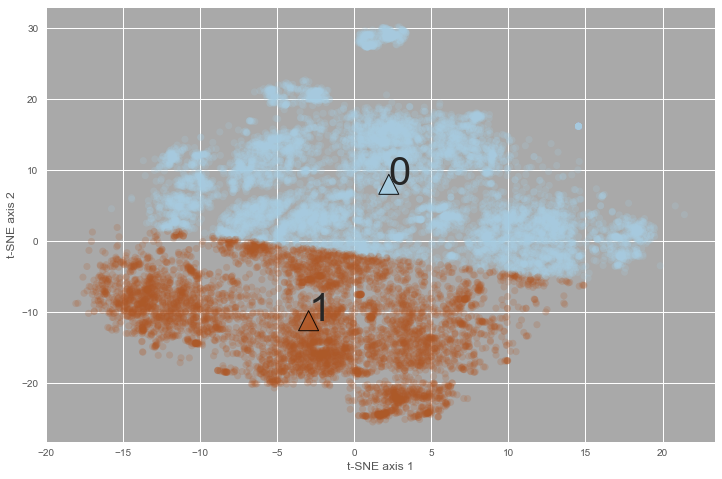

n_lda =  3


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=3, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  997314.52846
silhouette =  0.405846068838
0 -1.83116645504 11.6712149206 0
1 -3.70597350222 -11.4384983591 1
2 9.62563485902 0.297278928992 2


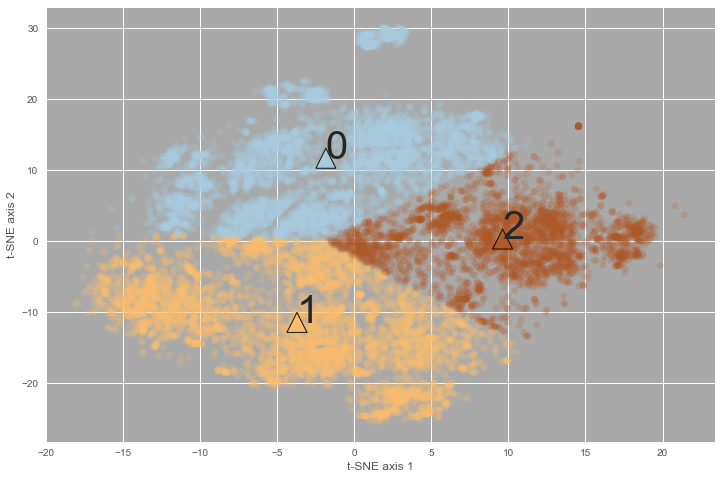

n_lda =  4


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=4, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  670036.813494
silhouette =  0.432432465545
0 -7.30739740839 -1.7649035563 0
1 0.423666061706 15.0076307734 1
2 10.4424376712 0.394533903037 2
3 0.101963854309 -15.4201097396 3


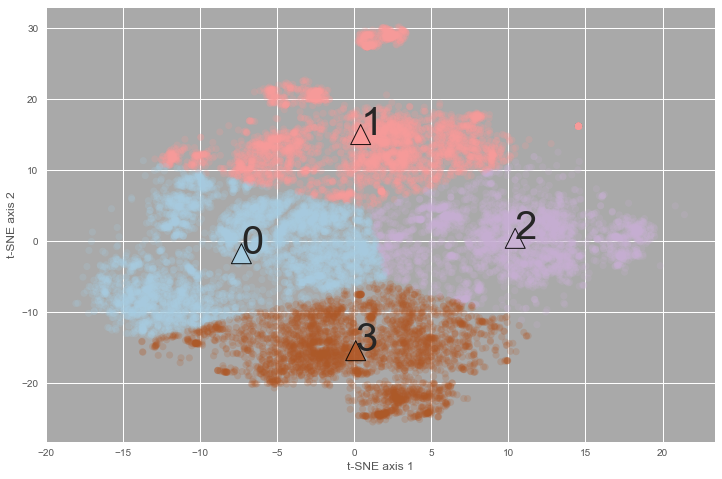

n_lda =  5


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=5, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  508142.503757
silhouette =  0.447762801369
0 0.919870075476 -15.3093239062 0
1 10.8119453663 0.38365782735 1
2 1.81882726369 16.1811438819 2
3 -11.5168419415 -8.71388080995 3
4 -4.93918506744 3.1130885894 4


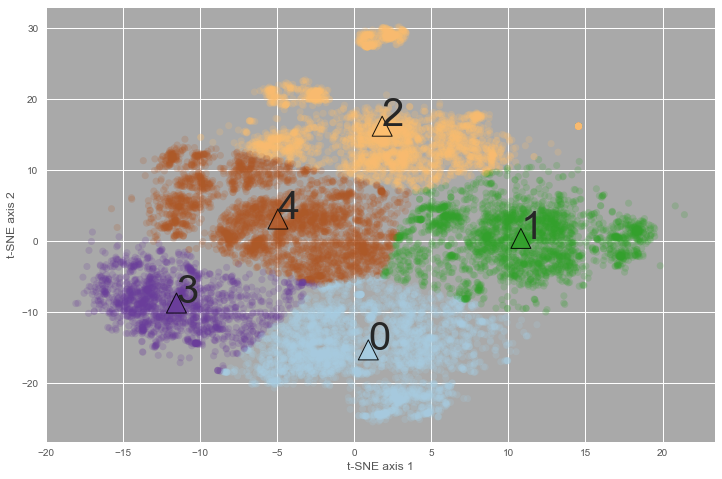

n_lda =  6


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=6, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  422878.109272
silhouette =  0.436858605796
0 -11.7957451754 -8.76237204911 0
1 2.76100450892 16.5533070254 1
2 -1.93065496299 -0.609908448376 2
3 0.950636478572 -15.7725028178 3
4 -7.31722754716 8.24660154745 4
5 11.4240572661 0.42953350405 5


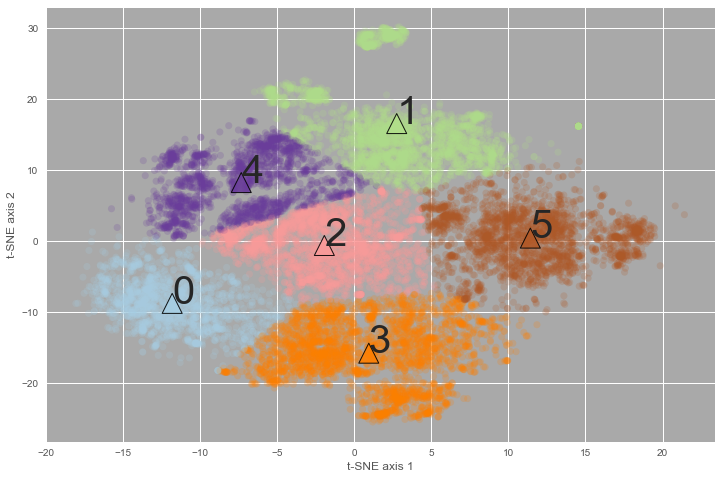

n_lda =  7


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  341590.75222
silhouette =  0.46043250966
0 -0.50489613144 25.0414045104 0
1 -1.9882164013 -0.800444741427 1
2 0.938968615673 -15.7965895173 2
3 11.5079142189 0.224019995263 3
4 -7.38371904274 8.30250030886 4
5 4.03410917208 13.1350629146 5
6 -11.7976595046 -8.75650189554 6


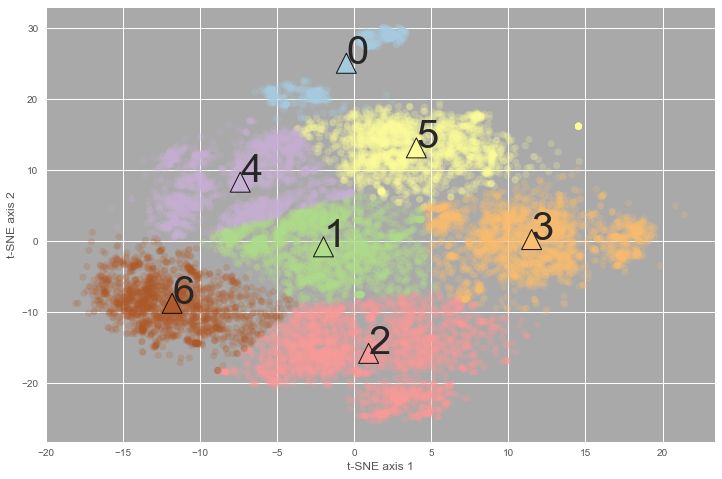

n_lda =  8


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=8, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  298617.483926
silhouette =  0.433442887134
0 -0.219327704707 -18.3027219625 0
1 -7.71896856769 8.88567756451 1
2 11.6975733872 0.573919027965 2
3 4.06519900088 13.1613953043 3
4 -2.46476795209 0.22607771895 4
5 -0.491904141623 25.0638692235 5
6 -11.8167781682 -8.68864807012 6
7 2.77954828654 -10.6288032553 7


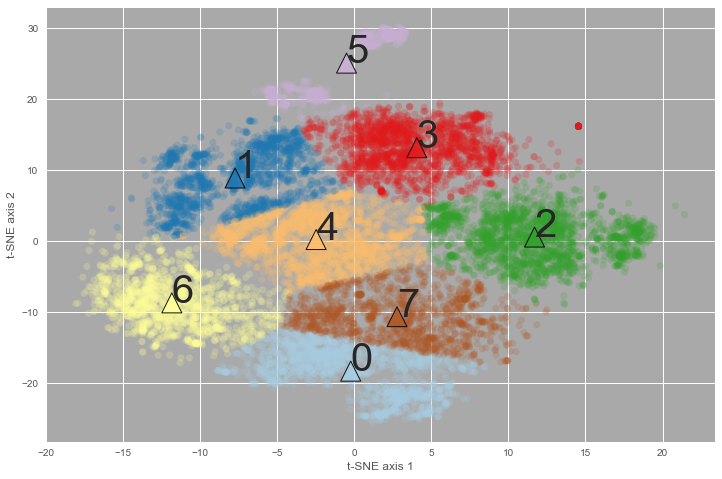

n_lda =  9


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=9, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  264032.146156
silhouette =  0.430663236774
0 -6.9016452821 11.3138096298 0
1 -2.9420355553 -14.5983769603 1
2 11.8230343204 0.582083910957 2
3 -12.2320661638 -8.47601986217 3
4 -0.468609178325 25.1086363336 4
5 1.09938960679 -3.94168158737 5
6 -5.74204428026 2.67693424971 6
7 4.07259859659 -17.9318574173 7
8 4.20936134319 13.0408499928 8


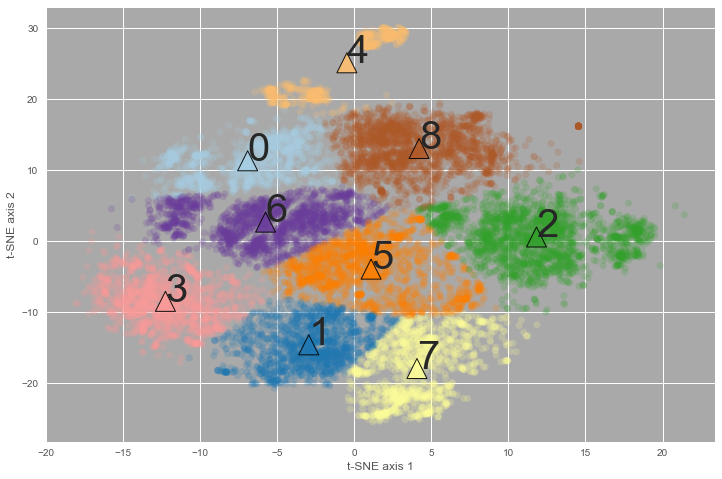

n_lda =  10


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=10, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  232805.142414
silhouette =  0.441795936768
0 -6.77885054975 11.3950425539 0
1 3.22047357248 -21.0573064319 1
2 -0.0868904318555 -1.86653983574 2
3 -12.2376699311 -8.51002312872 3
4 4.21636197012 13.0698639034 4
5 11.8782081909 0.595337390096 5
6 -3.09762269659 -14.6884015133 6
7 -0.468609178325 25.1086363336 7
8 4.96408118694 -11.5260727865 8
9 -6.43848736232 2.87611057417 9


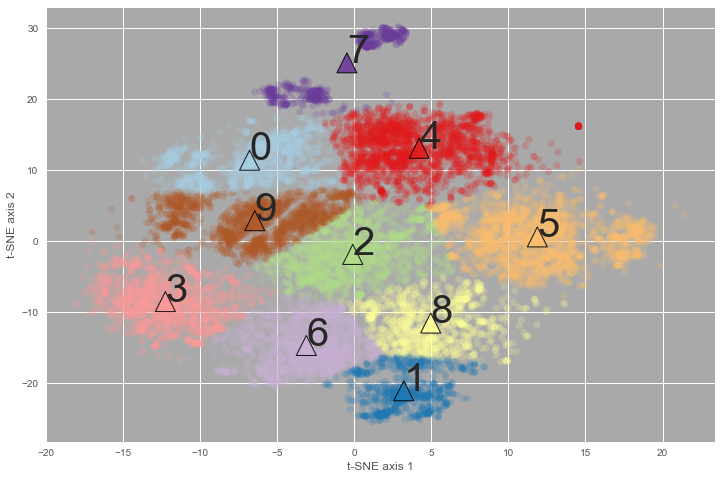

n_lda =  11


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=11, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  209876.569244
silhouette =  0.419008354448
0 7.25276554186 2.46172835987 0
1 -6.79357284818 11.388368106 1
2 -3.10291845343 -14.7647461461 2
3 4.16149390354 13.3510024964 3
4 -12.2576813458 -8.4845218025 4
5 -6.15182780009 2.91680915165 5
6 13.8043992756 -0.301631993271 6
7 -0.47315248821 25.1367649234 7
8 4.98168253613 -11.6216129189 8
9 3.20596460407 -21.0991147112 9
10 -0.767467053058 -2.96299289165 10


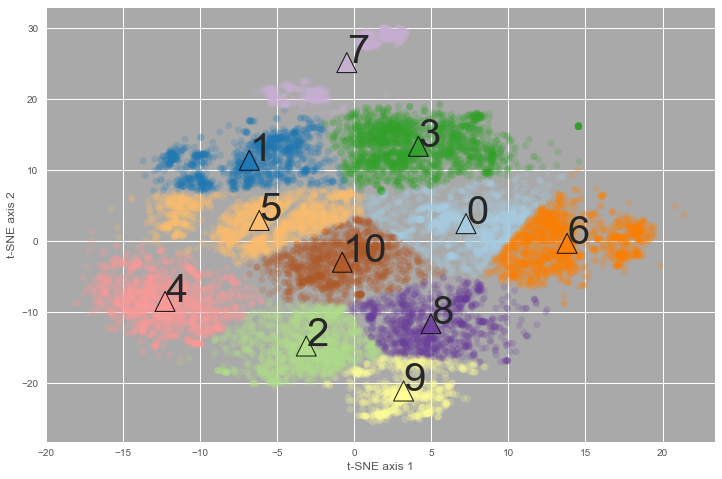

n_lda =  12


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=12, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  190043.291679
silhouette =  0.413836002749
0 -12.2536806035 -8.46020745626 0
1 4.51073126952 13.0766944451 1
2 4.98985466738 -11.6480119591 2
3 -4.58973771882 2.67098314455 3
4 7.94052650147 2.3995294802 4
5 -3.10291845343 -14.7647461461 5
6 3.20596460407 -21.0991147112 6
7 -3.43900741114 16.1227506313 7
8 -0.603806125441 -3.11428645915 8
9 1.77828834959 28.6188122983 9
10 13.9968523845 -0.498318832805 10
11 -9.56072404625 8.0145740278 11


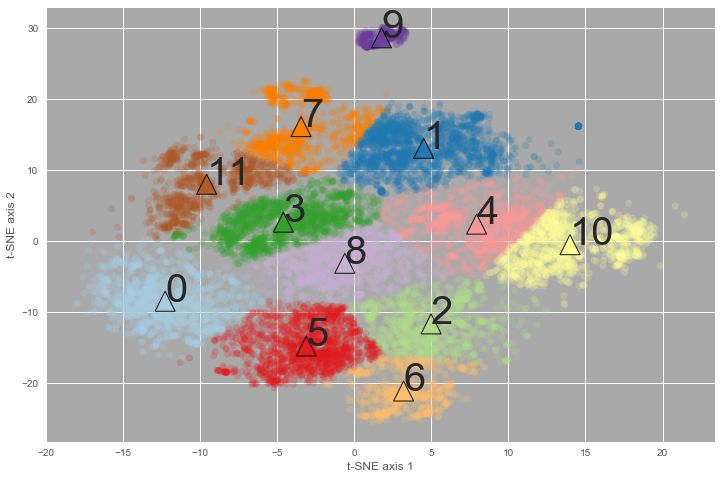

n_lda =  13


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=13, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  173109.226983
silhouette =  0.415088265749
0 -3.09146790365 -14.8159407197 0
1 -1.77121346374 4.19239374427 1
2 1.77828834959 28.6188122983 2
3 8.54481485576 2.36620068122 3
4 -12.2354540861 -8.62999126926 4
5 4.6696370666 13.2050126863 5
6 -0.657508570702 -3.29093769729 6
7 -8.46292076137 2.15383550037 7
8 4.99676573206 -11.6560841971 8
9 -7.34358683635 10.9264982121 9
10 14.1871513283 -0.754363514137 10
11 -2.43212104943 18.1052566409 11
12 3.22353045337 -21.1143829589 12


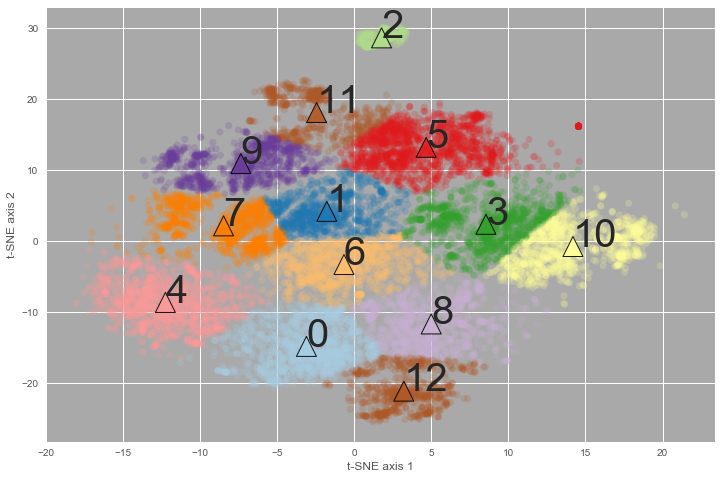

n_lda =  14


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=14, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  159757.562133
silhouette =  0.416694735617
0 -3.09263885252 -14.8463150504 0
1 -7.27216039021 11.0538932585 1
2 7.65809001878 1.96571800646 2
3 -0.885351706356 -3.51518133268 3
4 3.22353045337 -21.1143829589 4
5 7.7455948878 13.4192513948 5
6 1.77828834959 28.6188122983 6
7 -8.7582866637 2.12578105219 7
8 13.9789938228 -0.327201969216 8
9 2.0784954623 13.0380878263 9
10 -2.21319946638 3.80160847745 10
11 5.01029896164 -11.6531629498 11
12 -12.2260949579 -8.64079164542 12
13 -3.03028931174 19.1787630077 13


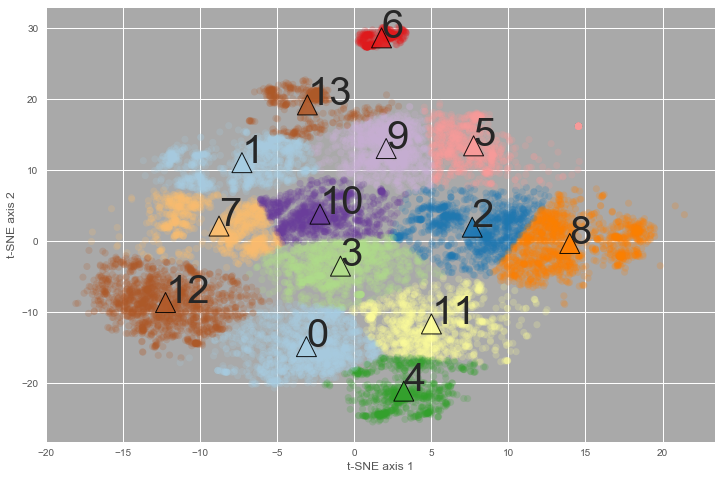

n_lda =  15


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=15, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  148010.301147
silhouette =  0.416564942707
0 -12.2370499338 -8.63096838197 0
1 7.74447918905 13.6282928338 1
2 4.69719452413 -12.1862667336 2
3 2.07829119786 13.0770931945 3
4 3.16637216872 -21.2980174267 4
5 -8.70307654539 2.10473723516 5
6 -7.26707577776 11.0527557033 6
7 10.604314768 -2.82007512058 7
8 15.2134473881 1.27303785757 8
9 -2.24172442721 3.84860040542 9
10 1.77828834959 28.6188122983 10
11 -3.16380233556 -14.8439092501 11
12 7.4927086521 3.28500263055 12
13 -0.752721703269 -3.40341465887 13
14 -3.03028931174 19.1787630077 14


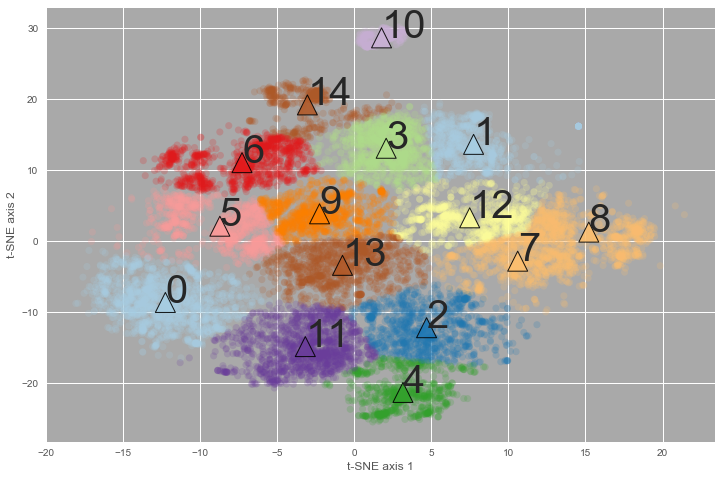

n_lda =  16


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=16, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  138307.272984
silhouette =  0.400019955903
0 2.05851606386 13.1536188488 0
1 -10.51671056 -11.1925369903 1
2 -1.95595930979 3.87062694723 2
3 -8.44353027216 2.249890767 3
4 -3.09886683345 19.1920961831 4
5 4.77294772869 -12.1410886081 5
6 15.2422033938 1.25340373884 6
7 -7.26596944301 11.0571067695 7
8 7.60211147237 3.27087556103 8
9 3.27432244742 -21.4323230059 9
10 -13.3036265887 -6.55176233609 10
11 -2.81766745593 -15.050728674 11
12 -0.759849308927 -3.4542837617 12
13 7.72214814969 13.5760817981 13
14 10.6154854274 -2.81759739492 14
15 1.77828834959 28.6188122983 15


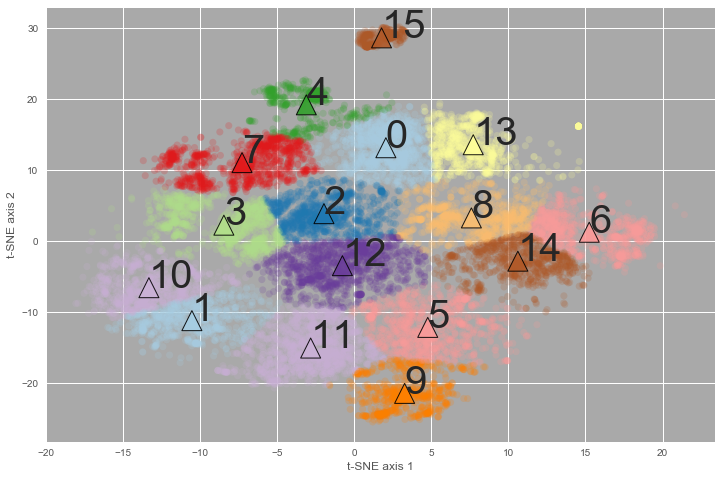

n_lda =  17


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=17, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  128821.467067
silhouette =  0.396453670978
0 -7.25896509371 11.0637067848 0
1 -3.02225127403 -16.3788156777 1
2 -2.08609617273 4.05238057457 2
3 2.05021436513 13.1790068692 3
4 -0.547188295461 -2.64677736312 4
5 -10.6768170867 -11.2214890146 5
6 5.12985108911 -13.2886823401 6
7 7.92622086196 3.27224856508 7
8 1.77828834959 28.6188122983 8
9 3.18631540729 -22.1548876297 9
10 15.3176975838 1.17735701185 10
11 -3.11239442959 19.2243593997 11
12 -13.2903451635 -6.48252982997 12
13 7.70630215774 13.5451316022 13
14 10.5307262485 -3.05670424128 14
15 -8.46833093992 2.23385766148 15
16 -1.19353707918 -9.98313732631 16


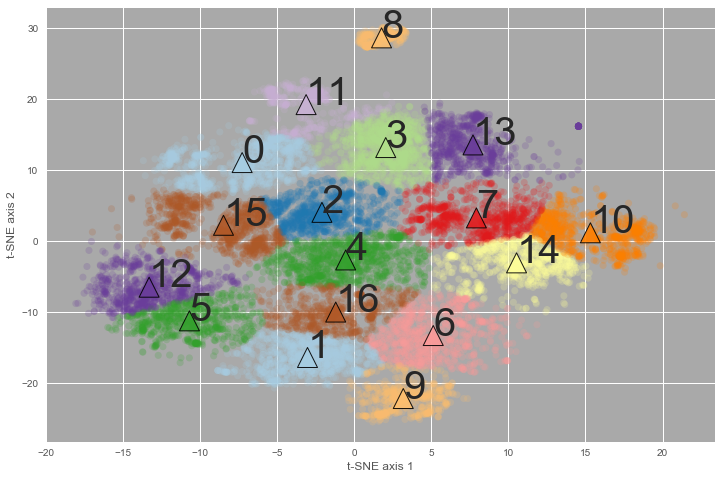

n_lda =  18


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=18, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  120327.561601
silhouette =  0.402585870648
0 -1.27981237625 -9.53575876087 0
1 -3.08103586531 19.760141657 1
2 10.5373531694 -3.01323676114 2
3 3.19164830559 -22.1202583409 3
4 -2.99716694678 -16.295006743 4
5 2.12540748235 13.2600221377 5
6 -10.4684238527 8.22162963638 6
7 -13.3113259941 -6.49219041425 7
8 5.10490371636 -13.2409712579 8
9 7.73438503534 13.5159369744 9
10 1.77828834959 28.6188122983 10
11 -5.24390097904 12.0992620234 11
12 -2.03691306179 4.26765941152 12
13 15.3130169606 1.17786304197 13
14 -7.48348213001 1.20779865415 14
15 7.91912238069 3.32003469445 15
16 -0.257931913652 -2.44160549185 16
17 -10.6430577399 -11.2539614199 17


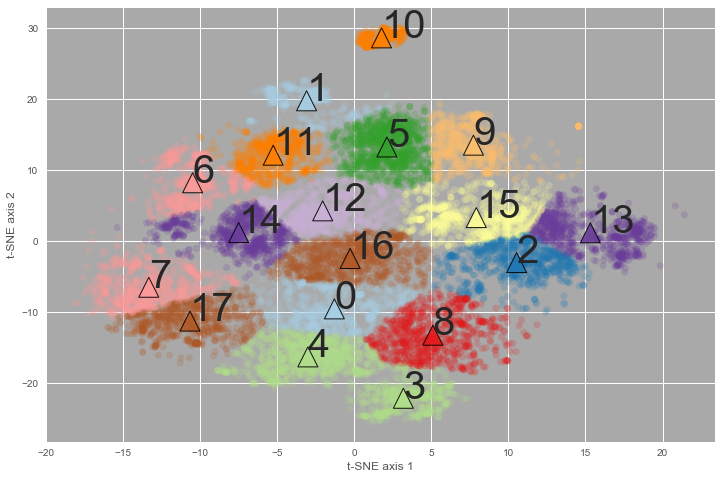

n_lda =  19


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=19, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  112636.196381
silhouette =  0.407332938241
0 3.1714208699 -22.2242635874 0
1 -2.78939433037 4.14108175951 1
2 -1.20411046217 -10.2144331579 2
3 2.04390357454 13.3506679868 3
4 -10.8508961644 5.45924148273 4
5 10.3357997051 -3.60987948915 5
6 -13.3042625864 -6.39949325346 6
7 -3.11320227014 -16.4032353676 7
8 16.9674361398 0.222923843399 8
9 -3.11243326723 19.5736261271 9
10 -6.51326435648 11.7258203217 10
11 11.1037829212 2.50252396474 11
12 1.77828834959 28.6188122983 12
13 -10.7457677697 -11.177894444 13
14 -0.511816788964 -3.07292002628 14
15 -6.61726541117 0.471955834356 15
16 4.9921195895 -13.5818689533 16
17 7.70722305265 13.5064355486 17
18 4.41041356806 3.66083865122 18


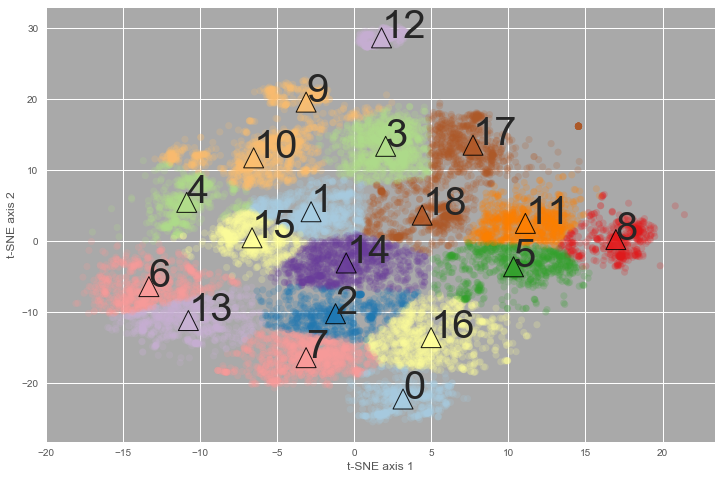

n_lda =  20


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=20, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  105160.554247
silhouette =  0.410238905086
0 -5.2102905618 12.1190302089 0
1 -3.19103170245 -16.5708293019 1
2 10.805988022 -2.65027559437 2
3 2.06744752319 13.360403917 3
4 -7.98262040317 1.03942660361 4
5 1.77828834959 28.6188122983 5
6 -2.93584240961 3.98811517625 6
7 4.31998741874 -15.1229850817 7
8 -10.6805012587 -11.248489504 8
9 11.2621909243 2.78147882209 9
10 4.41078985313 3.62452501446 10
11 3.20313479066 -22.4113085615 11
12 -10.4206395578 8.34798599281 12
13 7.71096408479 13.5082568727 13
14 5.84363223486 -9.1461484316 14
15 -3.11073927501 19.7786560794 15
16 -0.886593476925 -3.00267327642 16
17 -13.3154373275 -6.55316201272 17
18 -1.77610523249 -10.7023560657 18
19 17.1180104963 0.195909674617 19


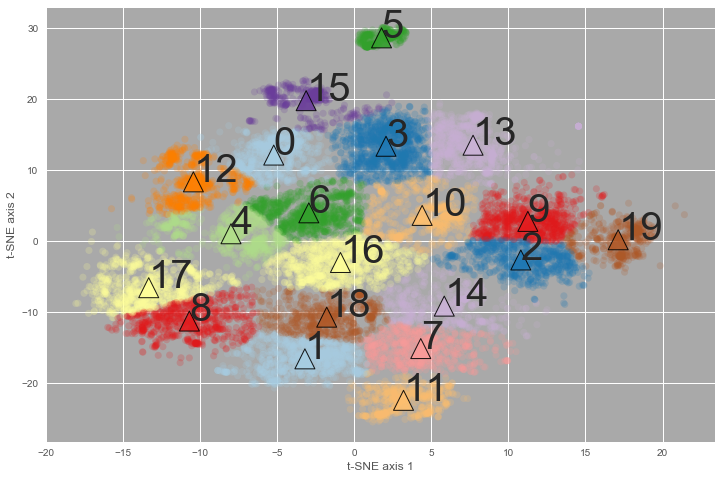

In [221]:
# ... k-means on the t-sne vectors

X_tsne = pd.DataFrame(columns=['t1', 't2'])
X_tsne['t1'] = df_join['x-tsne']
X_tsne['t2'] = df_join['y-tsne']

for n_lda in range(2, 21):  

    tic = time.clock()
    
    print ("n_lda = ", n_lda)

    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1);
    
    cls_lda.fit(X_tsne)

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_

    kmeans_inertia = cls_lda.inertia_
    print ("inertia = ", kmeans_inertia)
    
    kmeans_silhouette = metrics.silhouette_score(X_tsne,
                                                 kmeans_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", kmeans_silhouette)
    
    toc =  time.clock()
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - save statistics for model comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

    exe_time = '{0:.4f}'.format(toc-tic)
    
    raw_data = {
    'model_name' : 'KMeans - LDA features',
    'n_clusters' : n_lda,
    'inertia': kmeans_inertia,
    'silhouette': kmeans_silhouette, 
    'process_time' : exe_time
    }

    df_tbl = pd.DataFrame(raw_data,
    columns = ['model_name', 'n_clusters', 'inertia', 'silhouette', 'process_time'],
    index = [i_index + 1])

    kmeans_tbl = kmeans_tbl.append(df_tbl, ignore_index=True)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    
    _ = plt.figure(figsize=(12, 8));
    _ = plt.subplot(111, facecolor = 'darkgrey');
    
    X_tsne_values = X_tsne.values;
    _ = plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1],
                c = kmeans_labels,
                cmap = plt.cm.Paired,
                s = 50,
                linewidths = 0,
                alpha = 0.20);
    _ = plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.Paired,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);
    
    for ii in range(n_lda) :                                       
        _ = plt.text(kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii, fontsize = 40)
        print(ii, kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii)
    
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2');
    _ = plt.grid(True);

    plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - 
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-



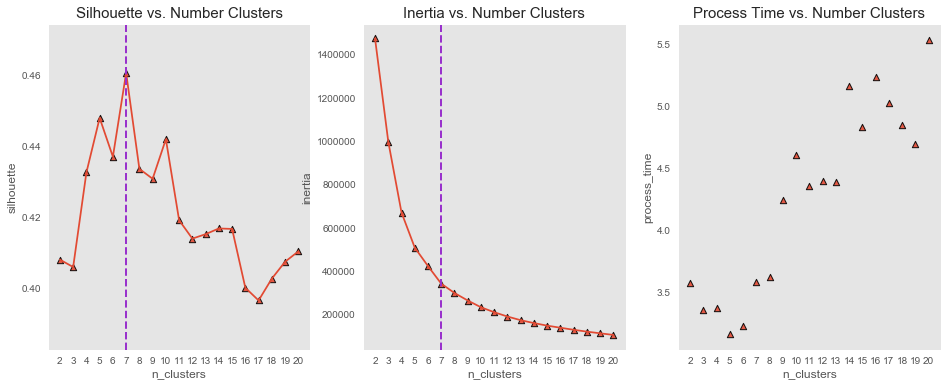

In [222]:

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ...  use max silhouette score to mark optimal c=number of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

n_optimal_clusters = kmeans_tbl['silhouette'].argmax() + kmeans_tbl['n_clusters'].min()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - plot metrics across models for comparison
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.figure(figsize=(16, 6));

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... silhouette values
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.subplot(131);
plt.scatter(kmeans_tbl['n_clusters'],
            kmeans_tbl['silhouette'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(kmeans_tbl['n_clusters'],
         kmeans_tbl['silhouette'])

plt.xlabel('n_clusters'), plt.ylabel('silhouette');
plt.title('Silhouette vs. Number Clusters', fontsize = 15)
plt.grid();

# ... vertical line for at max silhouette value

plt.axvline(x = n_optimal_clusters, linewidth = 2, linestyle = 'dashed', color = 'darkorchid')

xint = range(min(kmeans_tbl['n_clusters']), math.ceil(max(kmeans_tbl['n_clusters']))+1)
plt.xticks(xint)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... inertia values
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.subplot(132);
plt.scatter(kmeans_tbl['n_clusters'],
            kmeans_tbl['inertia'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);

plt.plot(kmeans_tbl['n_clusters'],
         kmeans_tbl['inertia'])

plt.xlabel('n_clusters'), plt.ylabel('inertia');
plt.title('Inertia vs. Number Clusters', fontsize = 15)
plt.grid();

# ... vertical line for at max silhouette value

plt.axvline(x = n_optimal_clusters, linewidth = 2, linestyle = 'dashed', color = 'darkorchid')

xint = range(min(kmeans_tbl['n_clusters']), math.ceil(max(kmeans_tbl['n_clusters']))+1)
plt.xticks(xint)

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... process time
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-

plt.subplot(133);
plt.scatter(kmeans_tbl['n_clusters'],
            kmeans_tbl['process_time'],
            s = 40,
            linewidths = 1.0,
            marker = '^',
            edgecolors = 'black',
            alpha = 0.90);
plt.xlabel('n_clusters'), plt.ylabel('process_time');
plt.title('Process Time vs. Number Clusters', fontsize = 15)
plt.grid();
xint = range(min(kmeans_tbl['n_clusters']), math.ceil(max(kmeans_tbl['n_clusters']))+1)
plt.xticks(xint)

plt.savefig("cluster_kmeans_number_of_clusters_eval.png")
    
plt.show();


### - choose kmeans clustering with preferred number of clusters  


n_lda =  7


KMeans(algorithm='auto', copy_x=True, init='k-means++', max_iter=300,
    n_clusters=7, n_init=10, n_jobs=1, precompute_distances='auto',
    random_state=1, tol=0.0001, verbose=0)

inertia =  341590.75222
silhouette =  0.460253963889


0 -0.50489613144 25.0414045104 0


1 -1.9882164013 -0.800444741427 1


2 0.938968615673 -15.7965895173 2


3 11.5079142189 0.224019995263 3


4 -7.38371904274 8.30250030886 4


5 4.03410917208 13.1350629146 5


6 -11.7976595046 -8.75650189554 6
[5 1 3 ..., 1 3 3]
[[ -0.50489613  25.04140451]
 [ -1.9882164   -0.80044474]
 [  0.93896862 -15.79658952]
 [ 11.50791422   0.22402   ]
 [ -7.38371904   8.30250031]
 [  4.03410917  13.13506291]
 [-11.7976595   -8.7565019 ]]


(<matplotlib.text.Text at 0x7fa0bc461240>,
 <matplotlib.text.Text at 0x7fa0d0a8b9b0>)

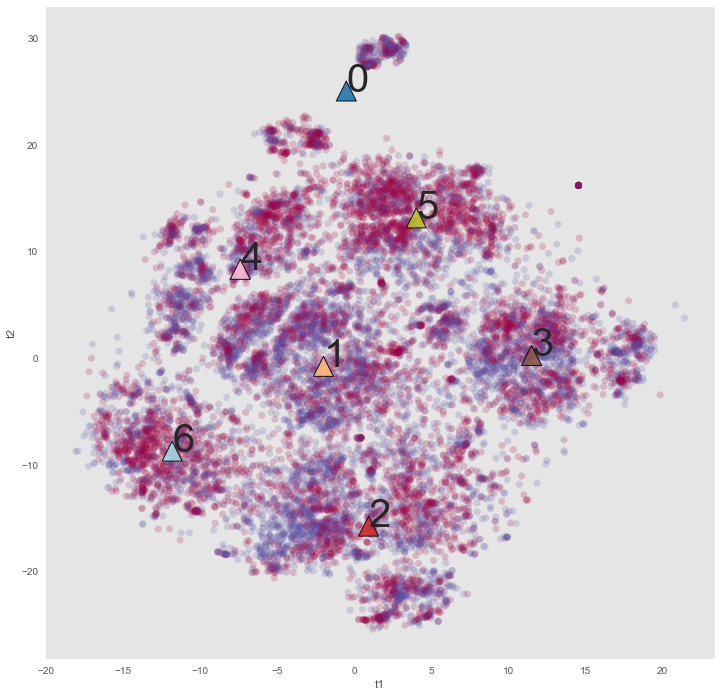

In [223]:

n_clusters_chosen = n_optimal_clusters

for n_lda in [n_clusters_chosen] :

    tic = time.clock()
    
    print ("n_lda = ", n_lda)

    cls_lda = KMeans(n_clusters = n_lda,
                     init = 'k-means++',
                     random_state = 1);
    
    cls_lda.fit(X_tsne)

    kmeans_labels = cls_lda.labels_ # the labels from kmeans clustering
    kmeans_centers = cls_lda.cluster_centers_

    kmeans_inertia = cls_lda.inertia_
    print ("inertia = ", kmeans_inertia)
    
    kmeans_silhouette = metrics.silhouette_score(X_tsne,
                                                 kmeans_labels,
                                                 metric = 'euclidean',
                                                 sample_size = 10000)
    print ("silhouette = ", kmeans_silhouette)
    
    toc =  time.clock()

# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - make some plots of clusters
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
    
    plt.figure(figsize=(12, 12));
    ax = plt.gca();
    
    X_tsne_values = X_tsne.values;
    plt.scatter(X_tsne_values[:, 0], X_tsne_values[:, 1],
                c = df_join['popular'],
                cmap = plt.cm.Spectral,
                s = 50,
                linewidths = 0,
                alpha = 0.20);
    plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.tab20,
                s = 400,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.90);    
    for ii in range(n_lda) :                                       
        plt.text(kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii, fontsize = 40)
        print(ii, kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii)

    print(kmeans_labels)
    print(kmeans_centers)
    
    
    plt.xlabel('t1'), plt.ylabel('t2');
    plt.grid();

    plt.show();
    
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-
# ... - print out comparison table
# ... -=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-




In [224]:
len(kmeans_labels)


13875

In [225]:

X_all_together = copy.deepcopy(df_join)

len(X_all_together)

X_all_together['kmeans_labels'] = kmeans_labels

#X_all_together.describe().T


13875

In [226]:
col_names = X_all_together.columns.values.tolist()


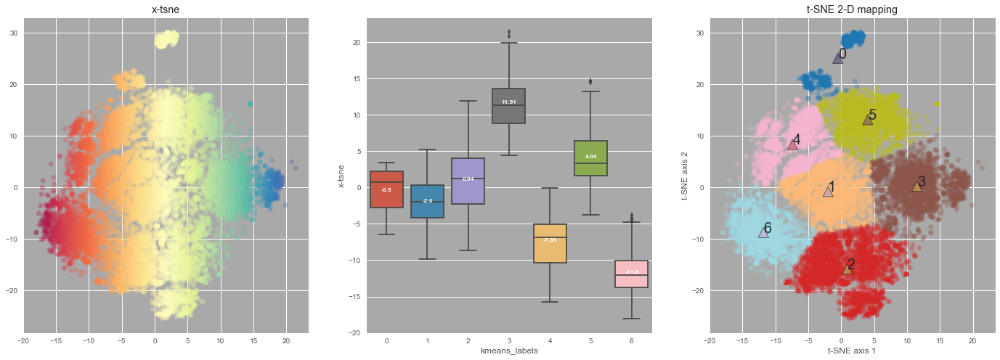

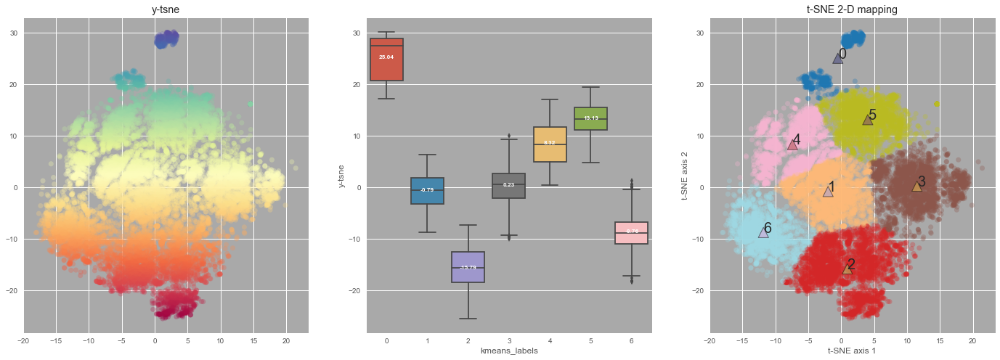

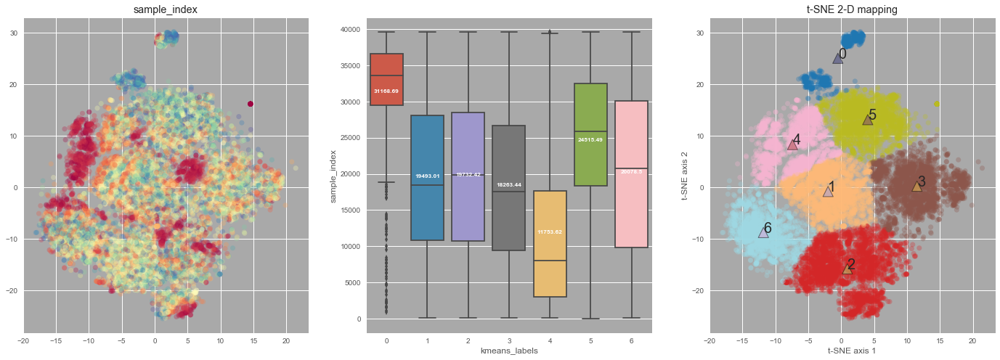

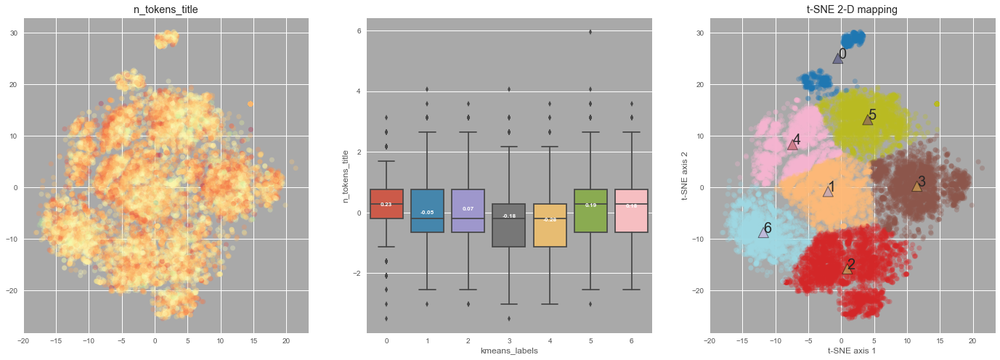

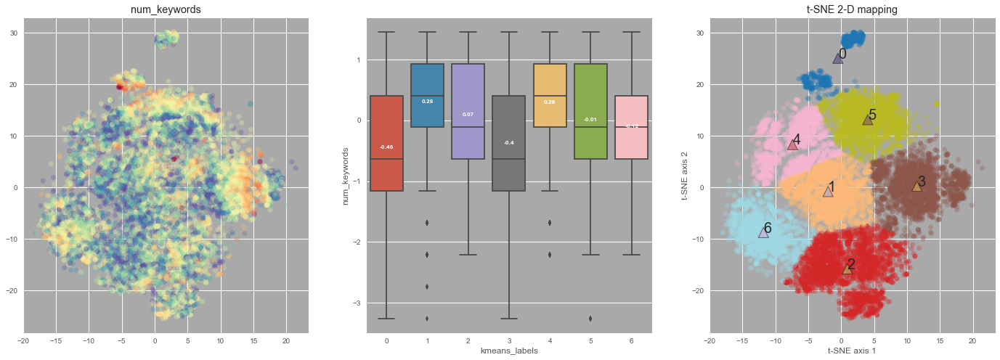

...

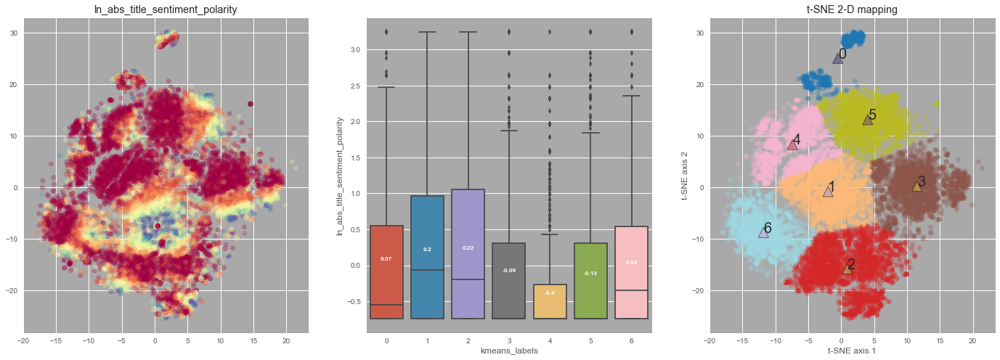

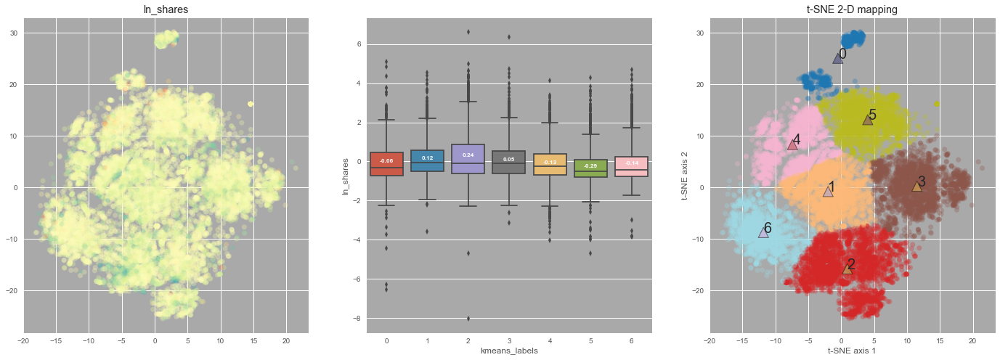

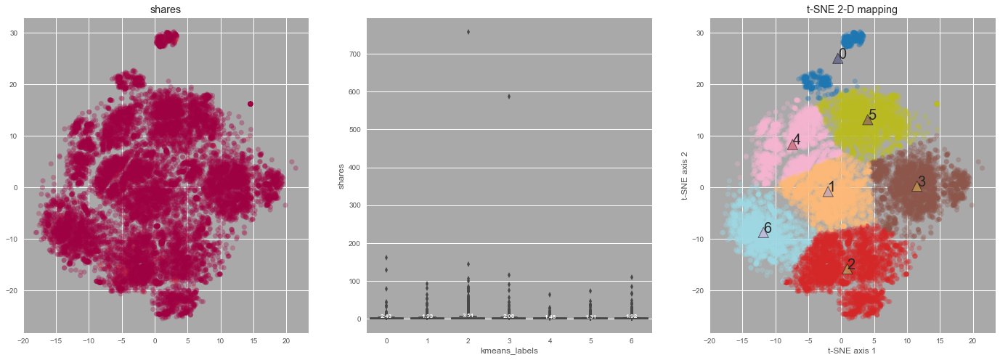

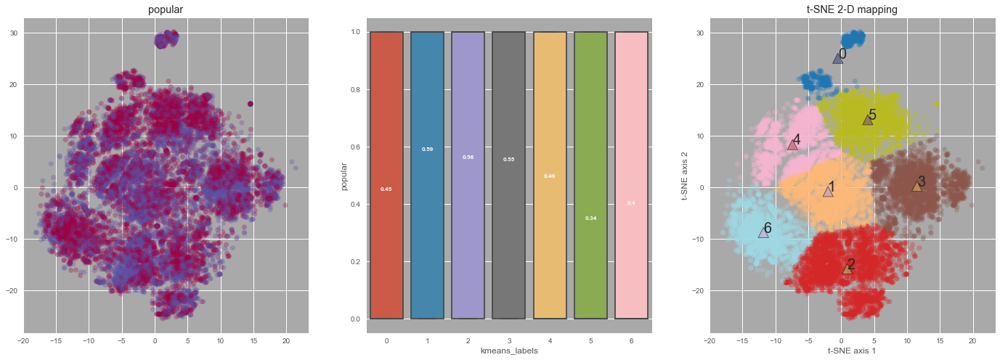

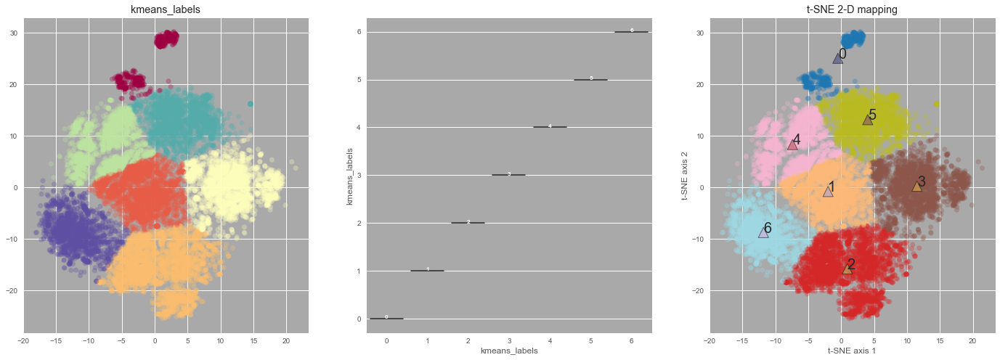

In [227]:
# boxplot across clusters for each feature ...
import seaborn as sns

col_names = X_all_together.columns.values.tolist()

for col in col_names :
    
    _ = plt.figure(figsize=(24, 8));
    
# ... feature distribution color map 

    _ = plt.subplot(131, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = X_all_together[col],
                 cmap = plt.cm.Spectral,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.title(col)
    
# ... feature boxplots

    _ = plt.subplot(132, facecolor = 'darkgrey');
    ax = sns.boxplot(x = "kmeans_labels", y = col, data = X_all_together);
    
    
    average_values = X_all_together.groupby(['kmeans_labels'])[col].mean().values
    average_labels = [str(np.round(s, 2)) for s in average_values]

    pos = range(len(average_values))
    for tick, label in zip(pos, ax.get_xticklabels()):
        
        _ = ax.text(pos[tick], average_values[tick], average_labels[tick], 
                horizontalalignment = 'center', size = 'small', color = 'w', weight = 'semibold')

# ... cluster color map
    
    _ = plt.subplot(133, facecolor = 'darkgrey');
    
    _ = plt.scatter(X_all_together['x-tsne'], X_all_together['y-tsne'],
                 c = kmeans_labels,
                 cmap = plt.cm.tab20,
                 s = 50,
                 linewidths = 0,
                 alpha = 0.30)
    _ = plt.scatter(kmeans_centers[:, 0], kmeans_centers[:, 1],
                c = range(n_lda),
                cmap = plt.cm.tab20b,
                s = 200,
                linewidths = 1.0,
                marker = '^',
                edgecolors = 'black',
                alpha = 0.50);    
    for ii in range(n_lda) :                                       
        _ = plt.text(kmeans_centers[ii, 0], kmeans_centers[ii, 1], ii, fontsize = 20)
        
    _ = plt.xlabel('t-SNE axis 1')
    _ = plt.ylabel('t-SNE axis 2')
    _ = plt.title('t-SNE 2-D mapping')
    
    plt.savefig("cluster_kmeans_3way_preplx_100__4clstrs%s.png" %col)
 
    _ = plt.show();
    

In [228]:
# ... summary table ... relative difference of each feature within each cluster


X_cluster_analysis = copy.deepcopy(X_all_together)
del X_cluster_analysis['x-tsne']
del X_cluster_analysis['y-tsne']
del X_cluster_analysis['sample_index']

grouped = X_cluster_analysis.groupby(['kmeans_labels'])

cluster_analysis_tbl = (grouped.mean() - X_cluster_analysis.mean()) / X_cluster_analysis.std()

cluster_analysis_tbl


,abs_title_subjectivity,data_channel_is_entertainment,data_channel_is_lifestyle,data_channel_is_socmed,global_rate_positive_words,global_subjectivity,is_weekend,kmeans_labels,kw_avg_max,ln_LDA_00,...,ln_shares,max_negative_polarity,max_positive_polarity,min_negative_polarity,n_tokens_title,num_keywords,popular,rate_positive_words,shares,title_sentiment_polarity
kmeans_labels,,,,,,,,,,,,,,,,,,,,,
0,0.016951,-0.102241,-0.080730,-0.106077,-1.468949,-2.255169,0.067397,NaN,0.920921,-0.270381,...,-0.060734,0.652178,-1.800653,0.924078,0.226416,-0.455412,-0.100763,-2.112869,0.027155,-0.062944
1,-0.233775,-0.421726,0.250079,-0.038291,0.316492,0.173205,0.040034,NaN,-0.217168,-0.301352,...,0.121026,0.087297,0.180070,0.190126,-0.046367,0.290797,0.178589,0.411827,-0.023539,0.286859
2,-0.008663,0.358478,-0.087076,-0.075050,0.118681,0.519336,0.033774,NaN,0.476073,-0.419810,...,0.241540,-0.226180,0.302020,-0.266520,0.070284,0.081739,0.124172,-0.024129,0.137175,0.068326
3,0.030040,-0.426727,-0.037439,0.411957,0.264478,-0.041397,-0.052572,NaN,0.294134,1.858211,...,0.047702,-0.140034,0.073756,0.081965,-0.174957,-0.388595,0.109104,0.342166,-0.008549,0.064226
4,0.315156,-0.414575,0.319485,-0.096686,-0.002195,0.013563,-0.099885,NaN,-0.826241,-0.410042,...,-0.125187,0.083207,-0.000316,0.140061,-0.279695,0.284659,-0.008119,0.160779,-0.068525,-0.178223
5,0.091434,-0.397310,-0.197028,-0.075129,-0.502870,-0.306790,0.017886,NaN,-0.118039,-0.405630,...,-0.286538,0.115101,-0.248766,-0.213624,0.190052,-0.005289,-0.303169,-0.285968,-0.085940,-0.232840
6,-0.187768,1.616334,-0.222965,-0.162774,0.230312,0.225837,0.023229,NaN,-0.275584,-0.437965,...,-0.138774,-0.033203,0.185512,-0.192205,0.177923,-0.114351,-0.195283,0.047673,-0.023985,-0.091267


<module 'matplotlib.pyplot' from '/home/mcdevitt/anaconda3/lib/python3.6/site-packages/matplotlib/pyplot.py'>

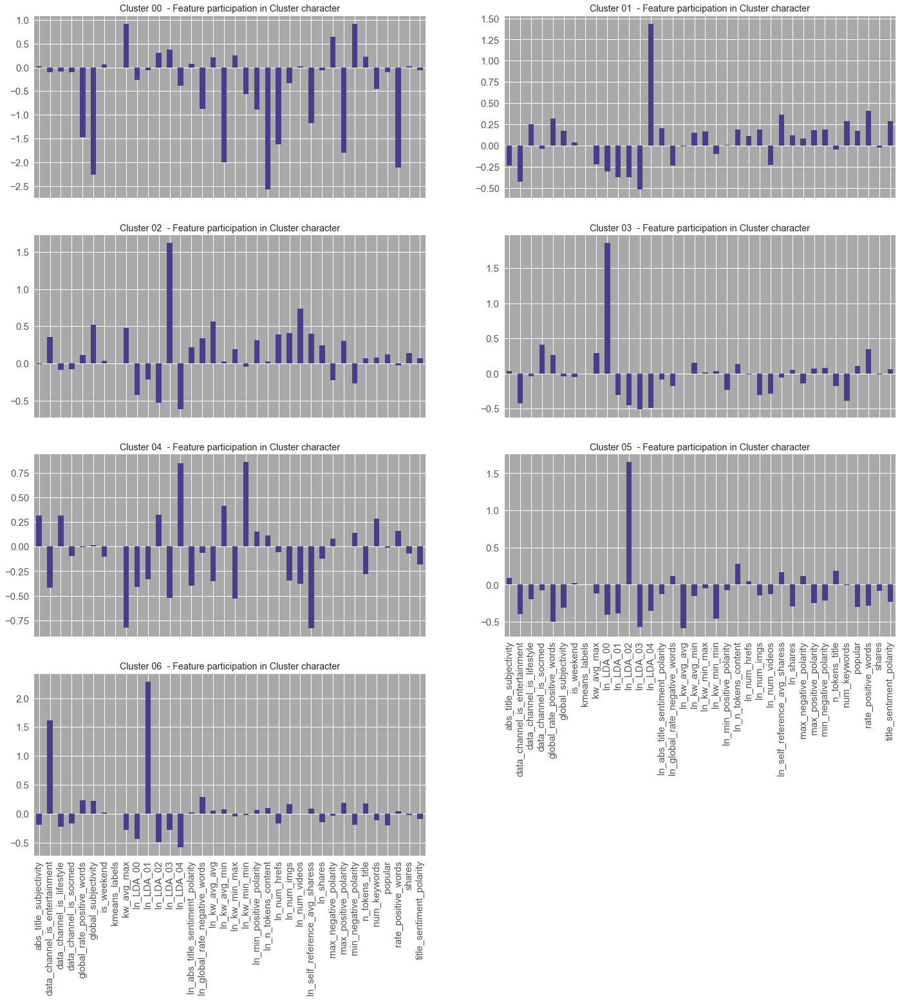

In [230]:


_ = plt.figure(figsize=(24, 24));
    
# .sort_values(ascending = False)

plot_rows = int((n_optimal_clusters + 1)/2)

for ii in range(n_optimal_clusters) :
    
    ax = plt.subplot(plot_rows, 2, ii+1, facecolor = 'darkgrey');
    
    if ii < n_optimal_clusters-1 :
        wgt = pd.Series(cluster_analysis_tbl.ix[ii])
    else :
        wgt = pd.Series(cluster_analysis_tbl.ix[ii],
                    index = cluster_analysis_tbl.columns)
        
    _ = wgt.plot(kind = 'bar', fontsize = 15, color = 'darkslateblue')
    
    _ = plt.grid(True)    
    if ii < n_optimal_clusters-2:
        _ = ax.xaxis.set_ticklabels([])
    
    _ = plt.title("Cluster %02d  - Feature participation in Cluster character" %ii)
    
plt.savefig("cluster_kmeans_cluster_barplots.png")

plt.show()

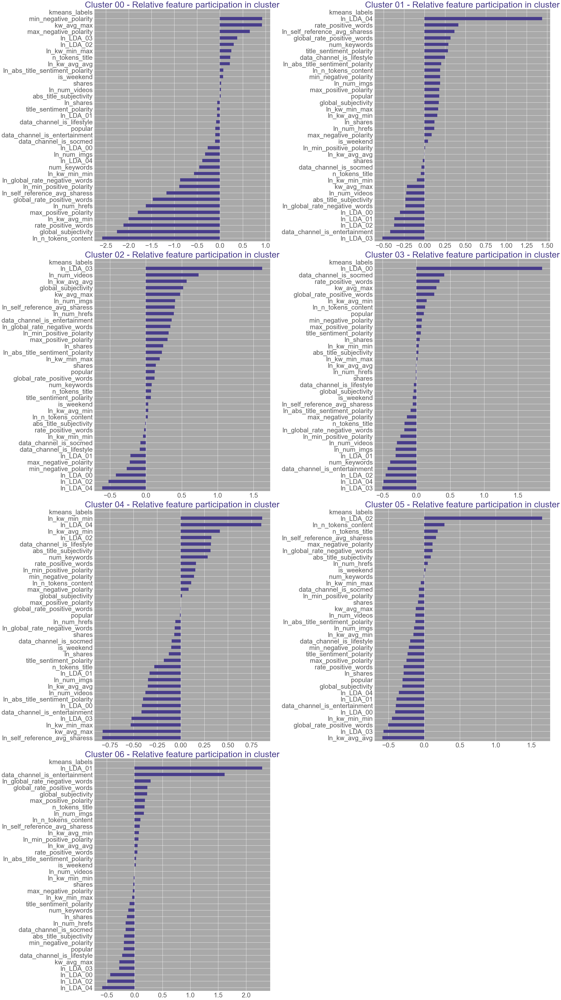

In [259]:

_ = plt.figure(figsize=(36, 64));
    

plot_rows = int((n_optimal_clusters + 1)/2)

for ii in range(n_optimal_clusters) :
    
    ax = plt.subplot(plot_rows, 2, ii+1, facecolor = 'darkgrey');
    
    wgt = pd.Series(cluster_analysis_tbl.ix[ii],
                    index = cluster_analysis_tbl.columns).sort_values(ascending = True)
        
    _ = wgt.plot(kind = 'barh', fontsize = 30, color = 'darkslateblue')
    
    _ = plt.title("Cluster %02d - Relative feature participation in cluster" %ii,
                  fontsize = 40,
                 color = 'darkslateblue')
    
    _ = plt.tight_layout()
    
plt.savefig("cluster_kmeans_cluster_barplots.png")

plt.show()

In [271]:
#cluster_analysis_tbl.T

cluster_analysis_tbl.ix[6].sort_values(ascending = False)

ln_LDA_01                          2.289188
data_channel_is_entertainment      1.616334
ln_global_rate_negative_words      0.286438
global_rate_positive_words         0.230312
global_subjectivity                0.225837
max_positive_polarity              0.185512
n_tokens_title                     0.177923
ln_num_imgs                        0.168162
ln_n_tokens_content                0.103773
ln_self_reference_avg_sharess      0.090570
ln_kw_avg_min                      0.076056
ln_min_positive_polarity           0.068751
ln_kw_avg_avg                      0.054551
rate_positive_words                0.047673
ln_abs_title_sentiment_polarity    0.027010
is_weekend                         0.023229
ln_num_videos                     -0.001451
ln_kw_min_min                     -0.016065
shares                            -0.023985
max_negative_polarity             -0.033203
ln_kw_min_max                     -0.042627
title_sentiment_polarity          -0.091267
num_keywords                    

<a href='#toc'> Table of Contents</a>

<a name='end_of_file'></a>
<font color="blue" size=3>  end of file